<a href="https://colab.research.google.com/github/dorzv/ComputerVision/blob/master/Diffusion/Diffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Intro to Diffusion Model
This notebook contains the implementation of a diffusion model according to the series of posts called [Intro to Diffusion model](https://dzdata.medium.com/intro-to-diffusion-model-part-1-29fe7724c043).

In [ ]:
import os
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

import datetime
import time

## Helper function

In [ ]:
def space_to_depth(x, size=2):
    """
    Downsacle method that use the depth dimension to
    downscale the spatial dimensions
    Args:
        x (torch.Tensor): a tensor to downscale
        size (float): the scaling factor

    Returns:
        (torch.Tensor): new spatial downscale tensor
    """
    b, c, h, w = x.shape
    out_h = h // size
    out_w = w // size
    out_c = c * (size * size)
    x = x.reshape((-1, c, out_h, size, out_w, size))
    x = x.permute((0, 1, 3, 5, 2, 4))
    x = x.reshape((-1, out_c, out_h, out_w))
    return x


class SpaceToDepth(nn.Module):
  def __init__(self, size):
    super().__init__()
    self.size = size

  def forward(self, x):
    return space_to_depth(x, self.size)


class Residual(nn.Module):
  """
  Apply residual connection using an input function
  Args:
    func (function): a function to apply over the input
  """
  def __init__(self, func):
    super().__init__()
    self.func = func

  def forward(self, x, *args, **kwargs):
    return x + self.func(x, *args, **kwargs)

def upsample(in_channels, out_channels=None):
  out_channels = in_channels if out_channels is None else out_channels
  seq = nn.Sequential(
      nn.Upsample(scale_factor=2, mode='nearest'),
      nn.Conv2d(in_channels, out_channels, 3, padding=1)
  )
  return seq

def downsample(in_channels, out_channels=None):
  out_channels = in_channels if out_channels is None else out_channels
  seq = nn.Sequential(
      SpaceToDepth(2),
      nn.Conv2d(4 * in_channels, out_channels, 1)
  )
  return seq




## Position embedding

In [ ]:
class SinusodialPositionEmbedding(nn.Module):
  def __init__(self, embedding_dim):
    super().__init__()
    self.embedding_dim = embedding_dim

  def forward(self, time_steps):
    positions = torch.unsqueeze(time_steps, 1)
    half_dim = self.embedding_dim // 2
    embeddings = torch.zeros((time_steps.shape[0], self.embedding_dim), device=time_steps.device)
    denominators = 10_000 ** (2 * torch.arange(self.embedding_dim // 2, device=time_steps.device) / self.embedding_dim)
    embeddings[:, 0::2] = torch.sin(positions/denominators)
    embeddings[:, 1::2] = torch.cos(positions/denominators)
    return embeddings


## Model Bulding Blocks

In [ ]:
class WeightStandardizedConv2d(nn.Conv2d):
  """
  https://arxiv.org/abs/1903.10520
  weight standardization purportedly works synergistically with group normalization
  """

  def forward(self, x):
    eps = 1e-5 if x.dtype == torch.float32 else 1e-3

    weight = self.weight
    mean = weight.mean(dim=[1,2,3], keepdim=True)
    variance = weight.var(dim=[1,2,3], keepdim=True, correction=0)
    normalized_weight = (weight - mean) / torch.sqrt(variance)

    return F.conv2d(
        x,
        normalized_weight,
        self.bias,
        self.stride,
        self.padding,
        self.dilation,
        self.groups
    )


class Block(nn.Module):
  def __init__(self, in_channels, out_channels, groups=8):
    super().__init__()
    self.proj = WeightStandardizedConv2d(in_channels, out_channels, 3, padding=1)
    self.norm = nn.GroupNorm(groups, out_channels)
    self.act = nn.SiLU()

  def forward(self, x, scale_shift=None):
    x = self.proj(x)
    x = self.norm(x)

    if scale_shift is not None:
      scale, shift = scale_shift
      x = x * (scale + 1) + shift

    x = self.act(x)
    return x

class ResnetBlock(nn.Module):
  def __init__(self, in_channels, out_channels, time_emb_dim=None, groups=8):
    super().__init__()
    if time_emb_dim is not None:
      self.mlp = nn.Sequential(
          nn.SiLU(),
          nn.Linear(time_emb_dim, 2 * out_channels)
      )
    else:
      self.mlp = None

    self.block1 = Block(in_channels, out_channels, groups)
    self.block2 = Block(out_channels, out_channels, groups)
    if in_channels == out_channels:
      self.res_conv = nn.Identity()
    else:
      self.res_conv = nn.Conv2d(in_channels, out_channels, 1)

  def forward(self, x, time_emb=None):
    scale_shift = None
    if self.mlp is not None and time_emb is not None:
      time_emb = self.mlp(time_emb)
      time_emb = time_emb.view(*time_emb.shape, 1, 1)
      scale_shift = time_emb.chunk(2, dim=1) ########

    h = self.block1(x, scale_shift=scale_shift)
    h = self.block2(h)
    return h + self.res_conv(x)


In [ ]:
class Attention(nn.Module):
  def __init__(self, in_channels, num_heads=4, dim_head=32):
    super().__init__()
    self.num_heads = num_heads
    self.dim_head = dim_head
    self.scale_factor = 1 / (dim_head) ** 0.5
    self.hidden_dim = num_heads * dim_head
    self.input_to_qkv = nn.Conv2d(in_channels, 3 * self.hidden_dim, 1, bias=False)
    self.to_output = nn.Conv2d(self.hidden_dim, in_channels, 1)

  def forward(self, x):
    b, c, h, w = x.shape
    qkv = self.input_to_qkv(x)
    q, k, v = map(lambda t: t.view(b, self.num_heads, self.dim_head, h * w), qkv.chunk(3, dim=1))
    q = q * self.scale_factor
    # dot product between the columns of q and k
    sim = torch.einsum("b h c i, b h c j -> b h i j", q, k)
    sim = sim - sim.amax(dim=-1, keepdim=True).detach()
    attention = sim.softmax(dim=-1)

    # dot product between the rows to get the wighted values as columns
    output = torch.einsum("b h i j, b h c j -> b h i c", attention, v)
    output = output.permute(0, 1, 3, 2).reshape((b, self.hidden_dim, h, w))
    return self.to_output(output)


class LinearAttention(nn.Module):
  def __init__(self, in_channels, num_heads=4, dim_head=32):
    super().__init__()
    self.num_heads = num_heads
    self.dim_head = dim_head
    self.scale_factor = 1 / (dim_head) ** 0.5
    self.hidden_dim = num_heads * dim_head
    self.input_to_qkv = nn.Conv2d(in_channels, 3 * self.hidden_dim, 1, bias=False)
    self.to_output = nn.Sequential(
        nn.Conv2d(self.hidden_dim, in_channels, 1),
        nn.GroupNorm(1, in_channels)
    )

  def forward(self, x):
    b, c, h, w = x.shape
    qkv = self.input_to_qkv(x)
    q, k, v = map(lambda t: t.view(b, self.num_heads, self.dim_head, h * w), qkv.chunk(3, dim=1))

    q = q.softmax(dim=-2)
    k = k.softmax(dim=-1)

    q = q * self.scale_factor
    context = torch.einsum("b h d n, b h e n -> b h d e", k, v)
    output = torch.einsum("b h d e, b h d n -> b h e n", context, q)
    output = output.view((b, self.hidden_dim, h, w))
    return self.to_output(output)

In [ ]:
class PreGroupNorm(nn.Module):
  def __init__(self, dim , func, groups=1):
    super().__init__()
    self.func = func
    self.group_norm = nn.GroupNorm(groups, dim)

  def forward(self, x):
    x = self.group_norm(x)
    x = self.func(x)
    return x

## The Unet Model

In [ ]:
class DiffusionUnet(nn.Module):
  def __init__(self, dim, init_dim=None, output_dim=None, dim_mults=(1, 2, 4, 8), channels=3, resnet_block_groups=4):
    super().__init__()

    self.channels = channels
    init_dim = init_dim if init_dim is not None else dim
    self.init_conv = nn.Conv2d(self.channels, init_dim, 1)
    dims = [init_dim] + [m * dim for m in dim_mults]
    input_output_dims = list(zip(dims[:-1], dims[1:]))

    time_dim = 4 * dim  # time embedding

    self.time_mlp = nn.Sequential(
        SinusodialPositionEmbedding(dim),
        nn.Linear(dim, time_dim),
        nn.GELU(),
        nn.Linear(time_dim, time_dim)
    )

    # down layers
    self.down_layers = nn.ModuleList([])
    for ii, (dim_in, dim_out) in enumerate(input_output_dims, 1):
      is_last = ii == len(input_output_dims)
      self.down_layers.append(
          nn.ModuleList(
              [
                  ResnetBlock(dim_in, dim_in, time_emb_dim=time_dim, groups=resnet_block_groups),
                  ResnetBlock(dim_in, dim_in, time_emb_dim=time_dim, groups=resnet_block_groups),
                  Residual(PreGroupNorm(dim_in, LinearAttention(dim_in))),
                  downsample(dim_in, dim_out) if not is_last else nn.Conv2d(dim_in, dim_out, 3, padding=1)
              ]
          )
      )

      # middle layers
      mid_dim = dims[-1]
      self.mid_block1 = ResnetBlock(mid_dim, mid_dim, time_emb_dim=time_dim, groups=resnet_block_groups)
      self.mid_attention = Residual(PreGroupNorm(mid_dim, Attention(mid_dim)))
      self.mid_block2 = ResnetBlock(mid_dim, mid_dim, time_emb_dim=time_dim, groups=resnet_block_groups)

      # up layers
      self.up_layers = nn.ModuleList([])
      for ii, (dim_in, dim_out) in enumerate(reversed(input_output_dims), 1):
        is_last = ii == len(input_output_dims)
        self.up_layers.append(
            nn.ModuleList(
                [
                    ResnetBlock(dim_out + dim_in, dim_out, time_emb_dim=time_dim, groups=resnet_block_groups),
                    ResnetBlock(dim_out + dim_in, dim_out, time_emb_dim=time_dim, groups=resnet_block_groups),
                    Residual(PreGroupNorm(dim_out, LinearAttention(dim_out))),
                    upsample(dim_out, dim_in) if not is_last else nn.Conv2d(dim_out, dim_in, 3, padding=1)
                ]
            )
        )

        self.output_dim = output_dim if output_dim is not None else channels
        self.final_res_block = ResnetBlock(2 * dim, dim, time_emb_dim=time_dim, groups=resnet_block_groups)
        self.final_conv = nn.Conv2d(dim, self.output_dim, 1)

  def forward(self, x, time):
    x = self.init_conv(x)
    init_result = x.clone()
    t = self.time_mlp(time)
    h = []

    for block1, block2, attention, downsample_block in self.down_layers:
      x = block1(x, t)
      h.append(x)

      x = block2(x, t)
      x = attention(x)

      h.append(x)

      x = downsample_block(x)

    x = self.mid_block1(x, t)
    x = self.mid_attention(x)
    x = self.mid_block2(x ,t)

    for block1, block2, attention, upsample_block in self.up_layers:
      x = torch.cat((x , h.pop()), dim=1)
      x = block1(x, t)

      x = torch.cat((x, h.pop()), dim=1)
      x = block2(x, t)

      x = attention(x)

      x = upsample_block(x)

    x = torch.cat((x, init_result), dim=1)
    x = self.final_res_block(x, t)
    x = self.final_conv(x)
    return x



## Schdulers

In [ ]:
def linear_schedule(num_timesteps):
  beta_start = 1e-4
  beta_end = 0.02
  betas = torch.linspace(beta_start, beta_end, num_timesteps)
  betas = torch.cat((torch.tensor([0]), betas))
  return betas

def cosine_schedule(num_timesteps, s=0.008):
  def f(t):
    return torch.cos((t / num_timesteps + s) / (1 + s) * 0.5 * torch.pi) ** 2
  x = torch.linspace(0, num_timesteps, num_timesteps + 1)
  alphas_cumprod = f(x) / f(torch.tensor([0]))
  betas = 1 - alphas_cumprod[1:] / alphas_cumprod[:-1]
  betas = torch.clip(betas, 0.0001, 0.999)
  return betas

## The Forward Processing

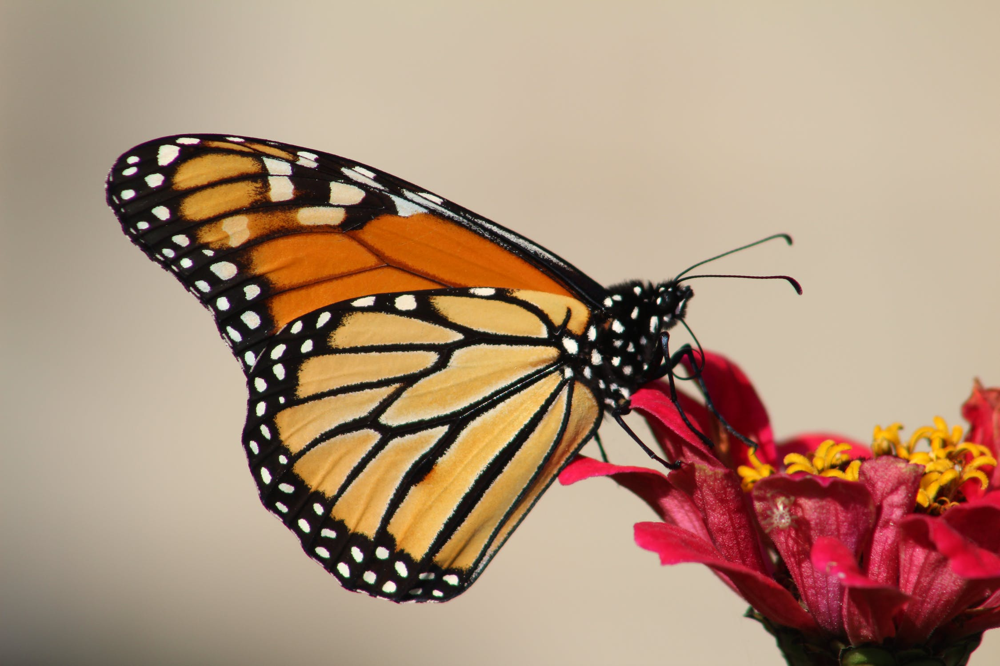

In [ ]:
import requests
from PIL import Image

url = 'https://images.pexels.com/photos/1557208/pexels-photo-1557208.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=2'
image_raw_data = requests.get(url, stream=True).raw
image = Image.open(image_raw_data)
image

In [ ]:
from torchvision.transforms import RandomHorizontalFlip, Compose, ToTensor, CenterCrop, Resize, Normalize

image_size = 64
transform = Compose([
  Resize((image_size, image_size)),
  # CenterCrop(image_size),
  RandomHorizontalFlip(),
  ToTensor(),
  Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
])

x0 = transform(image).unsqueeze(0)

In [ ]:
from torchvision.transforms import ToPILImage

reverse_transform_pil = Compose([
  Normalize(mean=(-1, -1, -1), std=(2, 2, 2)),
  ToPILImage()
])

reverse_transform_tensor = Compose([
  Normalize(mean=(-1, -1, -1), std=(2, 2, 2)),
])

In [ ]:
def sample_by_t(tensor_to_sample, timesteps, x_shape):
  batch_size = timesteps.shape[0]
  sampled_tensor = tensor_to_sample.gather(-1, timesteps.cpu())
  sampled_tensor = torch.reshape(sampled_tensor, (batch_size,) + (1,) * (len(x_shape) - 1))
  return sampled_tensor.to(timesteps.device)

In [ ]:
# Precalculatet the values of betas and alphas
num_timesteps = 1000
betas_t = linear_schedule(num_timesteps)

alphas_t = 1. - betas_t
alphas_bar_t = torch.cumprod(alphas_t, dim=0)
alphas_bar_t_minus_1 = torch.cat((torch.tensor([0]), alphas_bar_t[:-1]))
one_over_sqrt_alphas_t = 1. / torch.sqrt(alphas_t)
sqrt_alphas_t = torch.sqrt(alphas_t)
sqrt_alphas_bar_t = torch.sqrt(alphas_bar_t)
sqrt_alphas_bar_t_minus_1 = torch.sqrt(alphas_bar_t_minus_1)
sqrt_1_minus_alphas_bar_t = torch.sqrt(1. - alphas_bar_t)
# the variance of q(xₜ₋₁ | xₜ, x₀) as in part 3
posterior_variance = (1. - alphas_bar_t_minus_1) / (1. - alphas_bar_t) * betas_t

In [ ]:
def sample_q(x0, t, noise=None):
  if noise is None:
    noise = torch.randn_like(x0)

  sqrt_alphas_bar_t_sampled = sample_by_t(sqrt_alphas_bar_t, t, x0.shape)
  sqrt_1_minus_alphas_bar_t_sampled = sample_by_t(sqrt_1_minus_alphas_bar_t, t, x0.shape)
  x_t = sqrt_alphas_bar_t_sampled * x0 + sqrt_1_minus_alphas_bar_t_sampled * noise
  return x_t

In [ ]:
def get_noisy_image(x0, t, transform=reverse_transform_pil):
  x_noisy = sample_q(x0, t)
  noise_image = transform(x_noisy.squeeze())
  return noise_image

In [ ]:
import matplotlib.pyplot as plt
def show_noisy_images(noisy_images):
  num_of_image_sets = len(noisy_images)
  num_of_images_in_set = len(noisy_images[0])
  image_size = noisy_images[0][0].size[0]

  full_image = Image.new('RGB', (image_size * num_of_images_in_set + (num_of_images_in_set - 1), image_size * num_of_image_sets + (num_of_image_sets - 1)))
  for set_index, image_set in enumerate(noisy_images):
    for image_index, image in enumerate(image_set):
      full_image.paste(image, (image_index * image_size + image_index, set_index * image_size + set_index))

  plt.imshow(full_image)
  plt.axis('off')
  return full_image



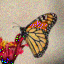

In [ ]:
t = torch.tensor([20])

get_noisy_image(x0, t)

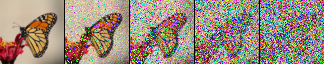

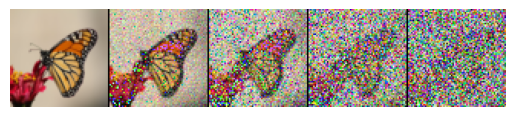

In [ ]:
show_noisy_images([[get_noisy_image(x0, torch.tensor([t])) for t in [0, 50, 100, 150, 200]]])

## Reverse Process Sampling

In [ ]:
@torch.no_grad()
def sample_p(model, x_t, t, clipping=True):
  """
  Sample from p_θ(xₜ₋₁|xₜ) to get xₜ₋₁ according to Algorithem 2
  """
  betas_t_sampled = sample_by_t(betas_t, t, x_t.shape)
  sqrt_1_minus_alphas_bar_t_sampled = sample_by_t(sqrt_1_minus_alphas_bar_t, t, x_t.shape)
  one_over_sqrt_alphas_t_sampled = sample_by_t(one_over_sqrt_alphas_t, t, x_t.shape)

  if clipping:
    sqrt_alphas_bar_t_sampled = sample_by_t(sqrt_alphas_bar_t, t, x_t.shape)
    sqrt_alphas_bar_t_minus_1_sampled = sample_by_t(sqrt_alphas_bar_t_minus_1, t, x_t.shape)
    alphas_bar_t_sampled = sample_by_t(alphas_bar_t, t, x_t.shape)
    sqrt_alphas_t_sampled = sample_by_t(sqrt_alphas_t, t, x_t.shape)
    alphas_bar_t_minus_1_sampled = sample_by_t(alphas_bar_t_minus_1, t, x_t.shape)

    x0_reconstruct = 1 / sqrt_alphas_bar_t_sampled * (x_t - sqrt_1_minus_alphas_bar_t_sampled * model(x_t, t))
    x0_reconstruct = torch.clip(x0_reconstruct, -1., 1.)
    predicted_mean = (sqrt_alphas_bar_t_minus_1_sampled * betas_t_sampled) / (1 - alphas_bar_t_sampled) * x0_reconstruct + (sqrt_alphas_t_sampled * (1 - alphas_bar_t_minus_1_sampled)) /  (1 - alphas_bar_t_sampled) * x_t

  else:
    predicted_mean = one_over_sqrt_alphas_t_sampled * (x_t - betas_t_sampled / sqrt_1_minus_alphas_bar_t_sampled * model(x_t, t))

  if t[0].item() == 1:
    return predicted_mean
  else:
    posterior_variance_sampled = sample_by_t(posterior_variance, t, x_t.shape)
    noise = torch.randn_like(x_t)
    return predicted_mean + torch.sqrt(posterior_variance_sampled) * noise


In [ ]:
from tqdm import tqdm
@torch.no_grad()
def sampling(model, shape, image_noise_steps_to_keep=1):
  """
  Implmenting Algorithm 2 - sampling.
  Args:
    model (torch.Module): the model that predictד the noise
    shape (tuple): shape of the data (batch, channels, image_size, image_size)
  Returns:
    (list): list containing the images in the different steps of the reverse process
  """

  batch = shape[0]
  images = torch.randn(shape, device=device)  # pure noise
  images_list = []

  for timestep in tqdm(range(num_timesteps, 0, -1), desc='sampling timestep'):
    images = sample_p(model, images, torch.full((batch,), timestep, device=device, dtype=torch.long))
    if timestep <= image_noise_steps_to_keep:
      images_list.append(images.cpu())
  return images_list

## Dataset and DataLoder

In [ ]:
!pip install datasets[vision] -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.6/519.6 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.8/294.8 kB 11.2 MB/s eta 0:00:00


In [ ]:
from datasets import load_dataset
from torch.utils.data import DataLoader
dataset = load_dataset("huggan/smithsonian_butterflies_subset", split='train')

Repo card metadata block was not found. Setting CardData to empty.


Extracting data files:   0%|          | 0/1 [00:00<?, ?it/s]

Generating train split:   0%|          | 0/1000 [00:00<?, ? examples/s]

In [ ]:
def transforms(data):
  images = [transform(im) for im in data['image']]
  return {'images': images}

dataset.set_transform(transforms)

batch_size=32
train_dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [ ]:
batch = next(iter(train_dataloader))
print('Shape:', batch['images'].shape,
      '\nBounds:', batch['images'].min().item(), 'to', batch['images'].max().item())


Shape: torch.Size([32, 3, 64, 64]) 
Bounds: -1.0 to 1.0


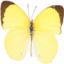

In [ ]:
reverse_transform_pil(batch['images'][20])

## Training

In [ ]:
from pathlib import Path
results_folder = Path("./results")
results_folder.mkdir(exist_ok = True)

In [ ]:
def compute_loss(model, x0, t, noise=None):
  if noise is None:
    noise = torch.randn_like(x0)

  x_t = sample_q(x0, t, noise)
  predicted_noise = model(x_t, t)
  loss = F.l1_loss(noise, predicted_noise)
  return loss

In [ ]:
from torch.optim import Adam

device = "cuda" if torch.cuda.is_available() else "cpu"
model = DiffusionUnet(dim=image_size, channels=3, dim_mults=(1, 2, 4, 8)).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)

In [ ]:
model_saved_file_path = Path('/content/gdrive/MyDrive/diffusion_checkpoints/saved_model.pth')
if model_saved_file_path.exists():
  saved_model = torch.load(str(model_saved_file_path))
else:
  model_saved_file_path.parent.mkdir(parents=True, exist_ok=True)
  saved_model = {}
  start_epoch = 0

In [ ]:
if saved_model:
    print('loading model')
    model.load_state_dict(saved_model['model'])
    optimizer.load_state_dict(saved_model['optimizer'])
    current_epoch = saved_model['epoch']

loading model


In [ ]:
import numpy as np
from torchvision.utils import save_image
epochs = 1000
loss_steps = 50
sample_every = 1000
loss_for_mean = np.zeros(loss_steps)
prev_time = time.time()
for epoch in range(start_epoch, epochs):
  for batch_index, batch in enumerate(train_dataloader):
    images = batch['images'].to(device)
    # sample t according to Algorithm 1
    t = torch.randint(1, num_timesteps, (images.shape[0],), device=device).long()
    loss = compute_loss(model, images, t)
    current_step = batch_index + epoch * len(train_dataloader)
    if current_step % loss_steps == 0:

      # Determine approximate time left
      batches_done = epoch * len(train_dataloader) + batch_index
      batches_left = epochs * len(train_dataloader) - current_step
      time_left = datetime.timedelta(seconds=batches_left * (time.time() - prev_time) / loss_steps)
      prev_time = time.time()

      print(f'Loss at epoch {epoch}, batch {batch_index}: {loss_for_mean.mean()} | time remaining: {time_left}')
      loss_for_mean[:] = 0
    loss_for_mean[current_step%loss_steps] = loss.item()

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if current_step % sample_every == 0:
      batch_to_sample = 5
      sample_images_list = sampling(model, (batch_to_sample, 3, image_size, image_size))
      sample_images = torch.cat(sample_images_list, dim=0)
      sample_images = reverse_transform_tensor(sample_images)
      save_image(sample_images, str(results_folder / f'sample_{current_step}.png'), nrow=batch_to_sample)

  saved_model['epoch'] = epoch + 1
  saved_model['model'] = model.state_dict()
  saved_model['optimizer']= optimizer.state_dict()
  torch.save(saved_model, '/content/gdrive/MyDrive/diffusion_checkpoints/saved_model.pth')


Loss at epoch 690, batch 20: 0.017869151718914508 | time remaining: 0:58:52.319275
Loss at epoch 692, batch 6: 0.03886259667575359 | time remaining: 1:32:28.682392
Loss at epoch 693, batch 24: 0.04251022107899189 | time remaining: 1:27:29.037101
Loss at epoch 695, batch 10: 0.04124796882271767 | time remaining: 1:39:39.039963
Loss at epoch 696, batch 28: 0.04288250915706158 | time remaining: 1:28:21.559488
Loss at epoch 698, batch 14: 0.04342370234429836 | time remaining: 1:30:52.185257
Loss at epoch 700, batch 0: 0.04168774124234915 | time remaining: 1:31:32.048355
Loss at epoch 701, batch 18: 0.04183699447661638 | time remaining: 1:26:21.336664
Loss at epoch 703, batch 4: 0.04085443537682295 | time remaining: 1:32:50.575075
Loss at epoch 704, batch 22: 0.04560236483812332 | time remaining: 1:25:03.841066
Loss at epoch 706, batch 8: 0.04049054253846407 | time remaining: 1:28:22.887137
Loss at epoch 707, batch 26: 0.0419497587531805 | time remaining: 1:29:25.576837
Loss at epoch 709, b

sampling timestep: 100%|██████████| 1000/1000 [00:32<00:00, 30.72it/s]


Loss at epoch 720, batch 10: 0.04086533024907112 | time remaining: 3:00:59.975891
Loss at epoch 721, batch 28: 0.041438141018152234 | time remaining: 1:21:42.981325
Loss at epoch 723, batch 14: 0.04124297112226486 | time remaining: 1:23:49.010373
Loss at epoch 725, batch 0: 0.04287165965884924 | time remaining: 1:23:55.179966
Loss at epoch 726, batch 18: 0.040062842704355714 | time remaining: 1:17:50.785308
Loss at epoch 728, batch 4: 0.03927067421376705 | time remaining: 1:22:54.821942
Loss at epoch 729, batch 22: 0.04089558869600296 | time remaining: 1:18:02.992024
Loss at epoch 731, batch 8: 0.042606723643839356 | time remaining: 1:20:43.325309
Loss at epoch 732, batch 26: 0.04443251557648182 | time remaining: 1:17:56.434827
Loss at epoch 734, batch 12: 0.0407315680757165 | time remaining: 1:20:06.477323
Loss at epoch 735, batch 30: 0.0405942527204752 | time remaining: 1:17:34.038021
Loss at epoch 737, batch 16: 0.04187727399170399 | time remaining: 1:19:55.367872
Loss at epoch 739,

sampling timestep: 100%|██████████| 1000/1000 [00:33<00:00, 29.46it/s]


Loss at epoch 751, batch 18: 0.04232810627669096 | time remaining: 2:40:48.613997
Loss at epoch 753, batch 4: 0.04019480243325233 | time remaining: 1:16:57.927628
Loss at epoch 754, batch 22: 0.043265381343662736 | time remaining: 1:11:54.225848
Loss at epoch 756, batch 8: 0.04245086591690779 | time remaining: 1:14:30.961799
Loss at epoch 757, batch 26: 0.0410409951210022 | time remaining: 1:10:56.675172
Loss at epoch 759, batch 12: 0.04006672266870737 | time remaining: 1:11:53.431612
Loss at epoch 760, batch 30: 0.04229875199496746 | time remaining: 1:09:01.958807
Loss at epoch 762, batch 16: 0.03902851764112711 | time remaining: 1:11:30.179764
Loss at epoch 764, batch 2: 0.03966567594558001 | time remaining: 1:11:22.581752
Loss at epoch 765, batch 20: 0.04126989342272282 | time remaining: 1:07:20.967679
Loss at epoch 767, batch 6: 0.04076092291623354 | time remaining: 1:10:43.904803
Loss at epoch 768, batch 24: 0.042180981524288653 | time remaining: 1:07:33.601737
Loss at epoch 770, 

sampling timestep: 100%|██████████| 1000/1000 [00:33<00:00, 29.55it/s]


Loss at epoch 782, batch 26: 0.03877483788877725 | time remaining: 2:18:55.238485
Loss at epoch 784, batch 12: 0.04124390535056591 | time remaining: 1:04:27.838353
Loss at epoch 785, batch 30: 0.041768078096210956 | time remaining: 1:02:20.898939
Loss at epoch 787, batch 16: 0.039268727339804174 | time remaining: 1:03:10.465410
Loss at epoch 789, batch 2: 0.03811806324869394 | time remaining: 1:03:32.638503
Loss at epoch 790, batch 20: 0.043672303520143035 | time remaining: 1:00:09.598387
Loss at epoch 792, batch 6: 0.03857726227492094 | time remaining: 1:03:59.846812
Loss at epoch 793, batch 24: 0.041790317483246325 | time remaining: 1:00:54.519505
Loss at epoch 795, batch 10: 0.041057425513863564 | time remaining: 1:01:41.247289
Loss at epoch 796, batch 28: 0.037518327459692954 | time remaining: 1:05:42.305362
Loss at epoch 798, batch 14: 0.038826556019484995 | time remaining: 1:00:47.173604
Loss at epoch 800, batch 0: 0.04166381023824215 | time remaining: 1:01:24.957092
Loss at epoc

sampling timestep: 100%|██████████| 1000/1000 [00:33<00:00, 29.42it/s]


Loss at epoch 814, batch 2: 0.040275845825672146 | time remaining: 2:02:36.102154
Loss at epoch 815, batch 20: 0.040331704691052433 | time remaining: 0:53:31.592075
Loss at epoch 817, batch 6: 0.042398243844509124 | time remaining: 0:56:29.116992
Loss at epoch 818, batch 24: 0.04073928270488977 | time remaining: 0:52:09.685063
Loss at epoch 820, batch 10: 0.040266168229281904 | time remaining: 0:54:21.064445
Loss at epoch 821, batch 28: 0.03950653273612261 | time remaining: 0:52:08.112089
Loss at epoch 823, batch 14: 0.0401079162210226 | time remaining: 0:52:24.545122
Loss at epoch 825, batch 0: 0.04012148078531027 | time remaining: 0:53:54.459530
Loss at epoch 826, batch 18: 0.04087502025067806 | time remaining: 0:50:22.712289
Loss at epoch 828, batch 4: 0.03809665448963642 | time remaining: 0:54:10.083525
Loss at epoch 829, batch 22: 0.04041321240365505 | time remaining: 0:49:41.435490
Loss at epoch 831, batch 8: 0.040637161694467065 | time remaining: 0:51:27.139784
Loss at epoch 832

sampling timestep: 100%|██████████| 1000/1000 [00:33<00:00, 30.27it/s]


Loss at epoch 845, batch 10: 0.038022961281239984 | time remaining: 1:40:45.988483
Loss at epoch 846, batch 28: 0.039912406206130985 | time remaining: 0:44:53.625506
Loss at epoch 848, batch 14: 0.03841005403548479 | time remaining: 0:45:51.692742
Loss at epoch 850, batch 0: 0.039067940823733806 | time remaining: 0:45:25.646072
Loss at epoch 851, batch 18: 0.041531915031373504 | time remaining: 0:42:24.542755
Loss at epoch 853, batch 4: 0.03972785394638777 | time remaining: 0:44:47.817206
Loss at epoch 854, batch 22: 0.041494876332581046 | time remaining: 0:41:55.257956
Loss at epoch 856, batch 8: 0.043351866640150546 | time remaining: 0:43:14.669623
Loss at epoch 857, batch 26: 0.04068026039749384 | time remaining: 0:41:16.663492
Loss at epoch 859, batch 12: 0.03903264041990042 | time remaining: 0:41:56.032047
Loss at epoch 860, batch 30: 0.04039886139333248 | time remaining: 0:40:17.025163
Loss at epoch 862, batch 16: 0.03708980400115251 | time remaining: 0:40:55.230347
Loss at epoch

sampling timestep: 100%|██████████| 1000/1000 [00:33<00:00, 30.06it/s]


Loss at epoch 876, batch 18: 0.04206720784306526 | time remaining: 1:18:25.368206
Loss at epoch 878, batch 4: 0.03697586141526699 | time remaining: 0:36:45.218851
Loss at epoch 879, batch 22: 0.03899758242070675 | time remaining: 0:34:46.065569
Loss at epoch 881, batch 8: 0.0373826390504837 | time remaining: 0:35:17.538690
Loss at epoch 882, batch 26: 0.042402210868895056 | time remaining: 0:34:26.387182
Loss at epoch 884, batch 12: 0.038294965773820876 | time remaining: 0:35:46.301483
Loss at epoch 885, batch 30: 0.03948379211127758 | time remaining: 0:32:45.434301
Loss at epoch 887, batch 16: 0.037732784859836103 | time remaining: 0:33:30.371962
Loss at epoch 889, batch 2: 0.04064481034874916 | time remaining: 0:33:55.769295
Loss at epoch 890, batch 20: 0.03938770826905966 | time remaining: 0:31:46.353796
Loss at epoch 892, batch 6: 0.03826333187520504 | time remaining: 0:33:27.661390
Loss at epoch 893, batch 24: 0.03750288523733616 | time remaining: 0:31:07.428736
Loss at epoch 895,

sampling timestep: 100%|██████████| 1000/1000 [00:34<00:00, 29.15it/s]


Loss at epoch 907, batch 26: 0.03782298259437084 | time remaining: 1:00:24.570243
Loss at epoch 909, batch 12: 0.03885909393429756 | time remaining: 0:27:16.495840
Loss at epoch 910, batch 30: 0.0389957338757813 | time remaining: 0:26:07.089695
Loss at epoch 912, batch 16: 0.03869121618568897 | time remaining: 0:26:13.409710
Loss at epoch 914, batch 2: 0.03722935412079096 | time remaining: 0:26:26.080929
Loss at epoch 915, batch 20: 0.03945419907569885 | time remaining: 0:24:32.126311
Loss at epoch 917, batch 6: 0.038662162199616434 | time remaining: 0:25:13.293721
Loss at epoch 918, batch 24: 0.03716996315866709 | time remaining: 0:23:32.364872
Loss at epoch 920, batch 10: 0.03926910009235143 | time remaining: 0:23:49.955746
Loss at epoch 921, batch 28: 0.03875336285680533 | time remaining: 0:22:53.967075
Loss at epoch 923, batch 14: 0.036862764582037924 | time remaining: 0:22:55.880650
Loss at epoch 925, batch 0: 0.038576661609113216 | time remaining: 0:23:55.969757
Loss at epoch 926

sampling timestep: 100%|██████████| 1000/1000 [00:33<00:00, 29.82it/s]


Loss at epoch 939, batch 2: 0.03814831156283617 | time remaining: 0:40:02.539146
Loss at epoch 940, batch 20: 0.0382276351749897 | time remaining: 0:17:12.562914
Loss at epoch 942, batch 6: 0.03716085318475962 | time remaining: 0:18:15.476294
Loss at epoch 943, batch 24: 0.037911846749484536 | time remaining: 0:16:31.624723
Loss at epoch 945, batch 10: 0.037194270566105844 | time remaining: 0:16:21.141398
Loss at epoch 946, batch 28: 0.03727407697588205 | time remaining: 0:15:24.890678
Loss at epoch 948, batch 14: 0.039128725230693814 | time remaining: 0:15:40.923178
Loss at epoch 950, batch 0: 0.03555229846388101 | time remaining: 0:15:11.116150
Loss at epoch 951, batch 18: 0.03977138843387365 | time remaining: 0:13:52.152754
Loss at epoch 953, batch 4: 0.03722818784415722 | time remaining: 0:14:06.966691
Loss at epoch 954, batch 22: 0.03676126042380929 | time remaining: 0:13:12.845734
Loss at epoch 956, batch 8: 0.03700133338570595 | time remaining: 0:13:06.967184
Loss at epoch 957, 

sampling timestep: 100%|██████████| 1000/1000 [00:33<00:00, 29.91it/s]


Loss at epoch 970, batch 10: 0.037039534710347655 | time remaining: 0:19:38.085485
Loss at epoch 971, batch 28: 0.03666490871459246 | time remaining: 0:08:19.235813
Loss at epoch 973, batch 14: 0.03674460839480162 | time remaining: 0:08:06.470580
Loss at epoch 975, batch 0: 0.03701229453086853 | time remaining: 0:07:44.595619
Loss at epoch 976, batch 18: 0.037533237859606744 | time remaining: 0:06:59.244028
Loss at epoch 978, batch 4: 0.03602780006825924 | time remaining: 0:06:48.853143
Loss at epoch 979, batch 22: 0.03764612816274166 | time remaining: 0:06:05.368236
Loss at epoch 981, batch 8: 0.04015901245176792 | time remaining: 0:05:46.730269
Loss at epoch 982, batch 26: 0.03722190964967012 | time remaining: 0:05:10.456740
Loss at epoch 984, batch 12: 0.03634066838771105 | time remaining: 0:04:49.390140
Loss at epoch 985, batch 30: 0.03650476850569248 | time remaining: 0:04:12.535386
Loss at epoch 987, batch 16: 0.038647069968283175 | time remaining: 0:04:24.288071
Loss at epoch 98

## Results

sampling timestep: 100%|██████████| 1000/1000 [01:10<00:00, 14.13it/s]


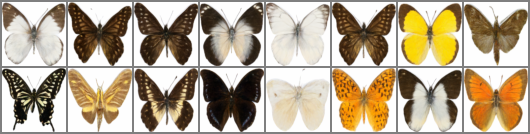

In [ ]:
from torchvision.utils import make_grid
reverse_transform_pil(make_grid(sampling(model, (16, 3, 64, 64))[-1], nrow=8))

sampling timestep: 100%|██████████| 1000/1000 [00:37<00:00, 26.47it/s]


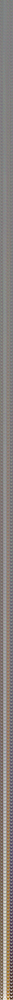

In [ ]:
image_steps_list = sampling(model, (4, 3, 64, 64), 300)
image_steps = torch.cat(image_steps_list, dim=0)
reverse_transform_pil(make_grid(image_steps, nrow=4))